# **<center>*EDA on Olympic Dataset***

![Logo](Olympics.jpg)

-----

## **Table of contents**

1. [Problem Statement](#Section1)<br>
<br> 
2. [Importing Pakages](#Section2)<br>
<br>
3. [Loading & Understanding Dataset](#Section3)<br>
    - 3.1 [athlete_events](#Section3.1)<br>
    - 3.2 [noc_regions](#Section3.2)<br>
<br>
4. [Data Profiling](#Section4)<br>
    - 4.1 [Pre-profiling](#Section4.1)<br>
    - 4.2 [Preprocessing](#Section4.2)
        - 4.2.1 [Treating Unwanted Columns](#Section4.2.1)
        - 4.2.2 [Treating Null Values](#Section4.2.2)
        - 4.2.3 [Add Required Columns](#Section4.2.3)
        - 4.2.4 [Treating Duplicate Values](#Section4.2.4)
    - 4.3 [Post-profiling](#Section4.3)<br>
<br>
5. [Exploratory Data Analysis](#Section5)<br>
<br>
6. [Questions](#Section6)<br>
<br>
7. [Conclusion](#Section7)<br>
<br>
8. [Future Work](#Section8)

***

<a id=Section1></a>

## **1. Problem Statment**


 - The modern Olympic Games or Olympics are the **leading international sporting events** featuring summer and winter sports competitions in which thousands of athletes from around the world participate in a variety of competitions.
 - The Olympic Games are considered the world's foremost sports competition with more than **200 teams**, representing sovereign states and territories, participating.
 - The Olympic Games **(Winter and Summer Games)** are normally held every four years till **1992**, and since **1994**, have alternated between the Summer and Winter Olympics every **two years during the four-year period**.
- This is a historical dataset on the modern Olympic Games, including all the Games from **Athens 1896** to **Rio 2016**.

- Our **goal** is to identify the connections between various Olympic data and study them to get **useful information**.

***

<a id=Section2></a>
## **2. Importing Pakages**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import ydata_profiling
from geopy.geocoders import Nominatim
from wordcloud import WordCloud, STOPWORDS
import warnings
warnings.filterwarnings("ignore")

***

<a id=Section3></a>
## **3. Loading & Understanding Dataset**
* **Two datasets** about the Olympic Games are used in this **Data Visualisation Notebook**. 
<a id=Section3.1></a>
### **3.1 athlete_events**

* The file athlete_events.csv contains **271116 rows** and **15 columns**. Each row corresponds to an individual athlete competing in an individual Olympic event (athlete-events).<br>
    
* The columns are:


|Sr. No.|Column Name|Description|
|----|------|------|
|1|ID|Unique number for each athlete|
|2|Name|Athlete's name|
|3|Sex|M or F|
|4|Age|Integer|
|5|Height|In centimeters|
|6|Weight|In kilograms|
|7|Team|Team name|
|8|NOC|National Olympic Committee 3-letter code|
|9|Games|Year and season|
|10|Year|Integer|
|11|Season|Summer or Winter|
|12|City|Host city|
|13|Sport|Sport|
|14|Event|Event|
|15|Medal|Gold, Silver, Bronze, or NA| 


In [2]:
data_athletes = pd.read_csv(r"athlete_events.csv")

* To see if there are any unnecessary columns when importing the dataset, let's inspect the first five rows of the data using the __*head()*__ function.

In [3]:
data_athletes.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN


* We use the __*info()*__ function to list the datatypes of all the 15 columns in our dataset.

In [4]:
data_athletes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 271116 entries, 0 to 271115
Data columns (total 15 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   ID      271116 non-null  int64  
 1   Name    271116 non-null  object 
 2   Sex     271116 non-null  object 
 3   Age     261642 non-null  float64
 4   Height  210945 non-null  float64
 5   Weight  208241 non-null  float64
 6   Team    271116 non-null  object 
 7   NOC     271116 non-null  object 
 8   Games   271116 non-null  object 
 9   Year    271116 non-null  int64  
 10  Season  271116 non-null  object 
 11  City    271116 non-null  object 
 12  Sport   271116 non-null  object 
 13  Event   271116 non-null  object 
 14  Medal   39783 non-null   object 
dtypes: float64(3), int64(2), object(10)
memory usage: 31.0+ MB


- There are 3 datatypes in our dataset:
    - __*int64*__ (Integer Numbers) **(2 Columns)**
    - __*Object*__ (This is basically a Strings, but there might be numerical data also) **(10 Columns)**
    - __*float64*__ (Decimal Numbers) **(3 Columns)**

* We will now compute some of the Dataset's fundamental statistical variables, such as the minimum, maximum, mean, and standard deviation etc. by using __*describe()*__ function.


In [5]:
data_athletes.describe()

,ID,Age,Height,Weight,Year
count,271116.000000,261642.000000,210945.000000,208241.000000,271116.000000
mean,68248.954396,25.556898,175.338970,70.702393,1978.378480
std,39022.286345,6.393561,10.518462,14.348020,29.877632
min,1.000000,10.000000,127.000000,25.000000,1896.000000
25%,34643.000000,21.000000,168.000000,60.000000,1960.000000
50%,68205.000000,24.000000,175.000000,70.000000,1988.000000
75%,102097.250000,28.000000,183.000000,79.000000,2002.000000
max,135571.000000,97.000000,226.000000,214.000000,2016.000000


* I discovered something crucial from the statistics figures above:

    * In the **Age** column, the minimum value is **10** and maximum value is **97**, a child as young as 10 years old and older peoples have both competed in one of the biggest sporting events in the world.

    * This suggests that some peoples are more athletic than adults. Let's check if they had win any medal or not.

    * comparing **75%**, **mean** and the **max** value of the **Age**, **Height** and **Weight** we can see that there are some **outliers** present in the dataset.

<a id=Section3.2></a>
### **3.2 noc_regions**

* The file noc_regions.csv contains **203 rows** and **3 columns**. Each row consist of NOC Code and the respective region.<br>

* The columns are:

|Sr. No.|Column Name|Description|
|----|------|------|
|1|NOC|National Olympic Committee 3-letter code|
|2|region|States|
|3|notes|Other information about the region|


* Now, let's quickly analyse the second dataset.

In [6]:
data_regions = pd.read_csv(r"noc_regions.csv")

In [7]:
data_regions.head()

,NOC,region,notes
0,AFG,Afghanistan,NaN
1,AHO,Curacao,Netherlands Antilles
2,ALB,Albania,NaN
3,ALG,Algeria,NaN
4,AND,Andorra,NaN


In [8]:
data_regions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 230 entries, 0 to 229
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   NOC     230 non-null    object
 1   region  227 non-null    object
 2   notes   21 non-null     object
dtypes: object(3)
memory usage: 5.5+ KB


* We'll get a single dataset by utilising the __*merge()*__ function, which will make our analysis easier.

In [9]:
data = pd.merge(data_athletes, data_regions, how="left", on="NOC")
data.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,region,notes
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN,China,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN,China,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN,Denmark,NaN
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,NaN
4,5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN,Netherlands,NaN


* Due to the the NOC column is shared by both datasets (data_athletes and data_regions), we superimpose the two columns and make sure the remaining columns of dataset data_regions are added to the left of data_athletes dataset.

***

<a id=Section4></a>
## **4. Data Preprocessing**

<a id=Section4.1></a>
### **4.1 Pandas Profiling before Processing**

* Here, we will perform **Pandas Profiling before preprocessing** our dataset, so we will name the **output file** as *__*Olympic_data_profiling_before_preprocessing.html*__*.

* This HTML file contains all the information about all columns present in the dataset. It's also gives us the **correlation** between different columns.

* It gives us **visual interpretation** of each column in the data.

* Then, with the help of **pandas profiling**, we will determine which of our dataset's **columns require preprocessing** and how to handle columns with **missing and duplicate** values.

In [10]:
profile = ydata_profiling.ProfileReport(data)
profile.to_file("Olympic_data_profiling_before_preprocessing.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

- ##### **Observations**

|Dataset statistics||Variable types||
|--------|--|---------|--|
|Number of variables|17|Numeric|5|
|Number of observations|271116|Categorical|12|
|Missing cells (%)|13.7%|||
|Duplicate rows (%)|0.2%|||

<br>

|Columns|Missing Values|% of Missing Values|How to Handle Null Values|Reason|
|------|--------|-------|------|------|
|Age|9474|3.5%|Replace Null values with Mean|Skewness=1.74, Kurtosis=6.27, Mean=25.55|
|Height|60171|22.2%|Replace Null values with Mean|Skewness=0.0184, Kurtosis=0.1777, Mean=175.33|
|Weight|62875|23.2%|Replace Null values with Mean|Skewness=0.797, Kurtosis=2.017, Mean=70.70|
|region|370|0.1%|Replace Null values with "Unknown"|We Don't Know that region|
|notes|266077|98.1%|We are going to drop this colunm|Irrelevant Column|
|Medal|231333|85.3%|Replace Null values with "Not Winner"|If there is NaN value, then that means the player doesn't win in that game|

- There are a total of 612 duplicate rows, so we will just drop them.

<a id=Section4.2></a>
### **4.2 Data Pre-processing**

<a id=Section4.2.1></a>
#### **4.2.1 Treating Unwanted Columns**

- Since the **ID**, **Games**, and **notes** columns don't provide any new information to the data, we don't need them.

In [11]:
data.drop(columns=["ID", "Games", "notes"], inplace=True, axis=1)
data.head()

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region
0,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN,China
1,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN,China
2,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920,Summer,Antwerpen,Football,Football Men's Football,NaN,Denmark
3,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark
4,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,NaN,Netherlands


<a id=Section4.2.2></a>
#### **4.2.2 Treating Null Values**

In [12]:
data.isnull().sum()

Name           0
Sex            0
Age         9474
Height     60171
Weight     62875
Team           0
NOC            0
Year           0
Season         0
City           0
Sport          0
Event          0
Medal     231333
region       370
dtype: int64

In [13]:
data.Age.fillna(data.Age.mean(), inplace=True)

In [14]:
data.Height.fillna(data.Height.mean(), inplace=True)

In [15]:
data.Weight.fillna(data.Weight.mean(), inplace=True)

In [16]:
data.Medal.fillna('Not Winner', inplace=True)

In [17]:
data.region.fillna('Unknown', inplace=True)

In [18]:
data.isnull().sum()

Name      0
Sex       0
Age       0
Height    0
Weight    0
Team      0
NOC       0
Year      0
Season    0
City      0
Sport     0
Event     0
Medal     0
region    0
dtype: int64

<a id=Section4.2.3></a>
#### **4.2.3 Add Required Columns**

In [19]:
def Country(x):
    geolocator = Nominatim(user_agent="geoapiExercises")
    location = geolocator.geocode(x, language="en")

    Latitude = str(location[1][0])
    Longitude = str(location[1][1])

    lat_long = geolocator.reverse(Latitude+","+Longitude, language="en")
    country = lat_long.raw["address"]["country"]
    return country

In [20]:
all_cities = []
for i in range(0,len(pd.unique(data.City))):
    x = data.City.unique()[i]
    all_cities.append(x)
print(all_cities)

['Barcelona', 'London', 'Antwerpen', 'Paris', 'Calgary', 'Albertville', 'Lillehammer', 'Los Angeles', 'Salt Lake City', 'Helsinki', 'Lake Placid', 'Sydney', 'Atlanta', 'Stockholm', 'Sochi', 'Nagano', 'Torino', 'Beijing', 'Rio de Janeiro', 'Athina', 'Squaw Valley', 'Innsbruck', 'Sarajevo', 'Mexico City', 'Munich', 'Seoul', 'Berlin', 'Oslo', "Cortina d'Ampezzo", 'Melbourne', 'Roma', 'Amsterdam', 'Montreal', 'Moskva', 'Tokyo', 'Vancouver', 'Grenoble', 'Sapporo', 'Chamonix', 'St. Louis', 'Sankt Moritz', 'Garmisch-Partenkirchen']


In [21]:
df_countries= pd.DataFrame({"City":all_cities})
df_countries['Country'] = df_countries['City'].apply(lambda x : Country(x))
df_countries.head()

,City,Country
0,Barcelona,Spain
1,London,United Kingdom
2,Antwerpen,Belgium
3,Paris,France
4,Calgary,Canada


In [22]:
data["Host_Country"] = np.nan

In [23]:
for i in range(len(data["City"])):    
    for j in range(len(df_countries["City"])):
        if data["City"][i] == df_countries["City"][j]:
            data["Host_Country"][i] = df_countries["Country"][j]

<a id=Section4.2.4></a>
####  **4.2.4 Treating Duplicate Values**

In [24]:
data.duplicated().sum()

1385

In [25]:
data.drop_duplicates(keep='first',inplace=True)

In [26]:
data.duplicated().sum()

0

<a id=Section4.3></a>
### **4.3 Pandas Profiling after Processing**

- Here, we will perform **Pandas Profiling after Pre-processing** our dataset, so we will name the **output file** as __Olympic_data_profiling_after_preprocessing.html__.

In [27]:
profile = ydata_profiling.ProfileReport(data)
profile.to_file("Olympic_data_profiling_after_preprocessing.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

|Dataset statistics||Variable types||
|--------|--|---------|--|
|Number of variables|15|Numeric|4|
|Number of observations|271116|Categorical|11|
|Missing cells (%)|0.0%|||
|Duplicate rows (%)|0.0%|||

<a id=Section5></a>
## **5. EDA**

**Exploratory Data Analysis(EDA)** is an **approach to analyzing data sets** to **summarize** their **main characteristics**, often with **visual methods**. 

- It includes **cleaning, munging, combining, reshaping, slicing, dicing, and transforming data** for **analysis** purpose.

- The **primary goal of EDA** is to **maximize the analyst's insight into a data set** and into the **underlying structure of a data set**, while **providing all of the specific items** that an **analyst would want to extract from a data set**, such as:


    - Finding **patterns** in Data.

    - Determining **relationships** in Data.

    - Checking of **assumptions**.

    - Preliminary selection of **appropriate models**.

    - Detection of **mistakes**.

<a id=Section6></a>
## **6. Questions**

- What is the Gender, Age, Height and Weight distribution?

- Which Olympic sports are the most well-known?

- Which nations have sent the maximum number of athletes over the years?

- Age differences between male and female Olympians?

- What is the relationship between athletes height, weight, and age across different sports?

- The overall trend of the summer and winter olympics over the years.

- Which nation has the highest medal tally?

- Which nation has the highest medal tally year and season wise?

- Which countries has the most Gold, Silver and Bronze medals?

- Which male and female athletes have won the most Olympic medals?

- Do any athletes who are older than 50 years have won medals?

- How many countries hosted Olympics?

- In which sports athletes have won most number of Medales?

- How many number of Sport held throughout the years?

- How many athletes Represent India in Olympics?

- How many athletes Win a medals for India in Olympics?

- When did India first participated in the Olympic Games?

- Who is the first Indian woman to win a medal in Olympics?

- Who won the first gold medal for India in Olympic Games?

- How many sports did India participate in Olympics?

- In which sport has India won the most Olympic medals?

### **6.1 Univarieate Analysis**

#### **6.1.1 Gender Distribution**

In [28]:
fig = go.Figure(data=[go.Pie(labels=data.Sex,
                             textinfo='label+percent')])

fig.update_layout(title="<b>Gender Distribustion</b>",
                  width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25), title_x=0.5)
fig.show()

- In terms of participation, **men** appear to be **predominating**.

#### **6.1.2 Age Distribution**

In [29]:
fig = px.histogram(data, x="Age")

fig.update_layout(width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25),
                  title="<b>Age Distribution</b>", title_x=0.5)

fig.show()

- From the above distribution we observe maximum participants are of **age** between **22–27** years.

#### **6.1.3 Weight Distribution**

In [30]:
fig = px.histogram(data, x="Weight")

fig.update_layout(width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25),
                  title="<b>Weight Distribution</b>", title_x=0.5)

fig.show()

- The maximum values for the **weight** varies from **50 kg** to **90 kg**. We can also see that there is dramatic increase at the weight of between 70.7 kg to 70.89 kg.

#### **6.1.4 Height Distribution**

In [31]:
fig = px.histogram(data, x="Height")

fig.update_layout(width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25),
                  title="<b>Height Distribution</b>", title_x=0.5)

fig.show()

- The range of the **height's** is between **160** and **190 cm**. Additionally, we can see that there is a sharp increase in height just about 175 cm.

#### **6.1.5 Well-known Sports in Olympics**

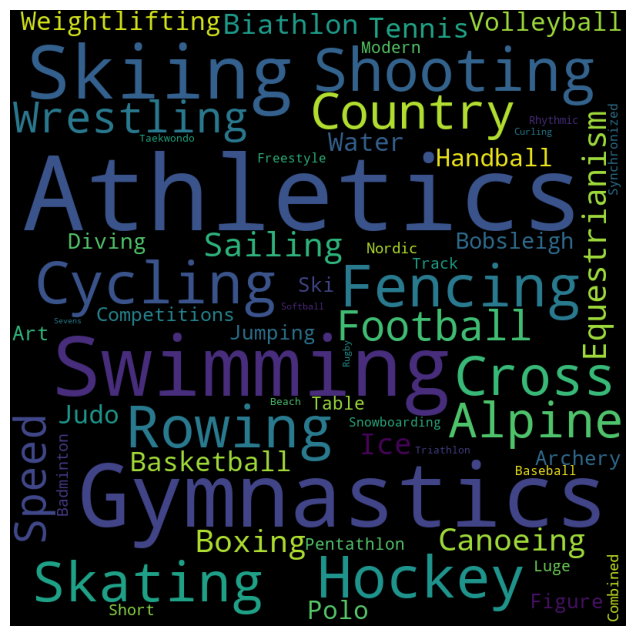

In [32]:
stopwords = set(STOPWORDS)
x = (data.Sport).to_string()

WC = WordCloud(width=800, height=800, background_color="Black",
               min_font_size=10, stopwords=stopwords, collocations=False).generate(x)

plt.figure(figsize=(8,8))
plt.imshow(WC)
plt.axis("off")
plt.show()

- **Gymnastics**, **Athletics** and **Swimming** have most numbers of participants and Events.

### **6.2 Multivariate Analysis**

#### **6.2.1 Top 10 countries that have sent the most athletes over time**

In [33]:
data_winter = data[data["Season"] == "Winter"]
data_winter.head()

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
4,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,Not Winner,Netherlands,Canada
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988,Winter,Calgary,Speed Skating,"Speed Skating Women's 1,000 metres",Not Winner,Netherlands,Canada
6,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 500 metres,Not Winner,Netherlands,France
7,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992,Winter,Albertville,Speed Skating,"Speed Skating Women's 1,000 metres",Not Winner,Netherlands,France
8,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 500 metres,Not Winner,Netherlands,Norway


In [34]:
data_summer = data[data["Season"] == "Summer"]
data_summer.head()

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
0,A Dijiang,M,24.0,180.00000,80.000000,China,CHN,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,Not Winner,China,Spain
1,A Lamusi,M,23.0,170.00000,60.000000,China,CHN,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,Not Winner,China,United Kingdom
2,Gunnar Nielsen Aaby,M,24.0,175.33897,70.702393,Denmark,DEN,1920,Summer,Antwerpen,Football,Football Men's Football,Not Winner,Denmark,Belgium
3,Edgar Lindenau Aabye,M,34.0,175.33897,70.702393,Denmark/Sweden,DEN,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,France
26,"Cornelia ""Cor"" Aalten (-Strannood)",F,18.0,168.00000,70.702393,Netherlands,NED,1932,Summer,Los Angeles,Athletics,Athletics Women's 100 metres,Not Winner,Netherlands,United States


In [35]:
fig = make_subplots(rows=2, cols=1, x_title="Countries", y_title="Count")

count_summer = data_summer['Team'].value_counts().reset_index().sort_values(by="Team", ascending=False)[:10]
count_summer.rename(columns={"index":"Team", "Team":"Count"}, inplace=True)
fig.add_trace(go.Bar(x=count_summer['Team'], y=count_summer['Count'], name="Summer"), row=1, col=1)


count_winter = data_winter['Team'].value_counts().reset_index().sort_values(by="Team", ascending=False)[:10]
count_winter.rename(columns={"index":"Team", "Team":"Count"}, inplace=True)
fig.add_trace(go.Bar(x=count_winter['Team'], y=count_winter['Count'], name="Winter"), row=2, col=1)

fig.update_layout(width=1150,height=550, 
                  title="<b>Top 10 Countries with Maximum no. of Athlete's</b>", title_x=0.5)

fig.show()

- This shows that we have more players from United States, Great Britain, France, Italy and Germany in **Summer Olympics**.

- This indicates we have more players from United States, Canada, Norway and Italy among other place in **Winter Olympics**.

- With a total of **17598** athletes, the **United States** dominates both Olympic competitions.

#### **6.2.2 The Overall Spread Of The Age Of Athletes In The Olympics.**

In [36]:
fig = px.box(data, x="Year", y="Age", color="Sex",color_discrete_sequence=["red", "green"])

fig.update_layout(width=1150,height=550, margin = dict(t=50, l=30, r=30, b=30),
                  title="<b>Variation of Athletes Age Over Time</b>", title_x=0.5, boxgroupgap=0.1, boxgap=0)
fig.show()

- The majority of the Olympic competitions over the years have seen athletes' **median ages** hover around **25**.

- The first Olympic competition in **1896** featured a **10-year-old** participant and no female athletes are present.

-  A male athlete who is **97 years** old competed in **1928** Olympics. 

#### **6.2.3 The relationship between athletes height, weight, and age across different sports.**

In [37]:
plot = px.scatter(data, x="Height", y="Weight", color='Sport',title="<b>Variation of Height & Weight Across Sports</b>")
plot.update_layout(width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25),autosize=True, title_x=0.5)
plot.show()

- Height and Weight ratio of the participants in the the sports of Weightlifiting and Basketball is on higher side.

- While in other sports such as Gymnastics and Rhythmic Gymnastics the ratio is on lower side.

#### **6.2.4 The overall trend of the Olympics over the years**

In [38]:
data_trend_summer= data_summer.groupby('Year').count()['Name'].reset_index()
data_trend_summer.rename(columns={"Name":"Count"},inplace=True)
data_trend_summer.head()

,Year,Count
0,1896,380
1,1900,1898
2,1904,1301
3,1906,1733
4,1908,3069


In [39]:
data_trend_winter= data_winter.groupby('Year').count()['Name'].reset_index()
data_trend_winter.rename(columns={"Name":"Count"},inplace=True)
data_trend_winter.head()

,Year,Count
0,1924,460
1,1928,582
2,1932,352
3,1936,895
4,1948,1075


In [40]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=data_trend_summer["Year"], y=data_trend_summer["Count"],
                    mode='lines+markers',
                    name='Summer Games'))
fig.add_trace(go.Scatter(x=data_trend_winter["Year"], y=data_trend_winter["Count"],
                    mode='lines+markers',
                    name='Winter Games'))

fig.update_layout(width=1150,height=550, margin = dict(t=50, l=25, r=25, b=25),
                  title="<b>Overall Trend of the Olympics Over the Years</b>", title_x=0.5, xaxis_title="Year", yaxis_title="No. of Athelet's")

fig.show()

- We can clearly observe that there is a **sharp decrease** in the number of participants in the years **1932**, **1956**, and **1980**, despite the fact that the overall trends have been progressively trending upward throughout the years.

#### **6.2.5 The variation of male & female participants over the years in the Olympics**

In [41]:
data_female_winter = data[(data["Sex"]=="F") & (data["Season"]=="Winter")]
data_female_winter.head(3)

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
4,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,Not Winner,Netherlands,Canada
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988,Winter,Calgary,Speed Skating,"Speed Skating Women's 1,000 metres",Not Winner,Netherlands,Canada
6,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 500 metres,Not Winner,Netherlands,France


In [42]:
data_female_summer = data[(data["Sex"]=="F") & (data["Season"]=="Summer")]
data_female_summer.head(3)

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
26,"Cornelia ""Cor"" Aalten (-Strannood)",F,18.0,168.0,70.702393,Netherlands,NED,1932,Summer,Los Angeles,Athletics,Athletics Women's 100 metres,Not Winner,Netherlands,United States
27,"Cornelia ""Cor"" Aalten (-Strannood)",F,18.0,168.0,70.702393,Netherlands,NED,1932,Summer,Los Angeles,Athletics,Athletics Women's 4 x 100 metres Relay,Not Winner,Netherlands,United States
32,Minna Maarit Aalto,F,30.0,159.0,55.500000,Finland,FIN,1996,Summer,Atlanta,Sailing,Sailing Women's Windsurfer,Not Winner,Finland,United States


In [43]:
data_male_winter = data[(data["Sex"]=="M") & (data["Season"]=="Winter")]
data_male_winter.head(3)

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
10,Per Knut Aaland,M,31.0,188.0,75.0,United States,USA,1992,Winter,Albertville,Cross Country Skiing,Cross Country Skiing Men's 10 kilometres,Not Winner,USA,France
11,Per Knut Aaland,M,31.0,188.0,75.0,United States,USA,1992,Winter,Albertville,Cross Country Skiing,Cross Country Skiing Men's 50 kilometres,Not Winner,USA,France
12,Per Knut Aaland,M,31.0,188.0,75.0,United States,USA,1992,Winter,Albertville,Cross Country Skiing,Cross Country Skiing Men's 10/15 kilometres Pu...,Not Winner,USA,France


In [44]:
data_male_summer = data[(data["Sex"]=="M") & (data["Season"]=="Summer")]
data_male_summer.head(3)

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
0,A Dijiang,M,24.0,180.00000,80.000000,China,CHN,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,Not Winner,China,Spain
1,A Lamusi,M,23.0,170.00000,60.000000,China,CHN,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,Not Winner,China,United Kingdom
2,Gunnar Nielsen Aaby,M,24.0,175.33897,70.702393,Denmark,DEN,1920,Summer,Antwerpen,Football,Football Men's Football,Not Winner,Denmark,Belgium


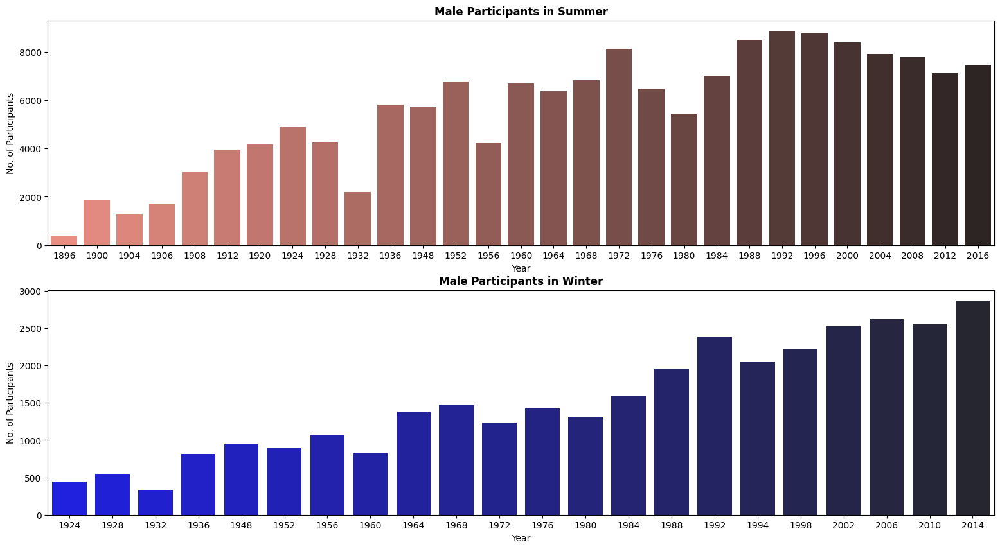

In [45]:
plt.figure(figsize=(19,10))

plt.subplot(211)
sns.countplot(data=data_male_summer,x="Year", palette="dark:salmon_r")
plt.title('Male Participants in Summer', weight="bold")
plt.ylabel("No. of Participants")

plt.subplot(212)
sns.countplot(data=data_male_winter,x="Year", palette="dark:blue_r")
plt.title('Male Participants in Winter', weight="bold")
plt.ylabel("No. of Participants")

plt.show()

- We can see that the number of male competitors **fell slightly** after the Summer Games in **1996**.


- However, The trend of Winter Games is on the rise.

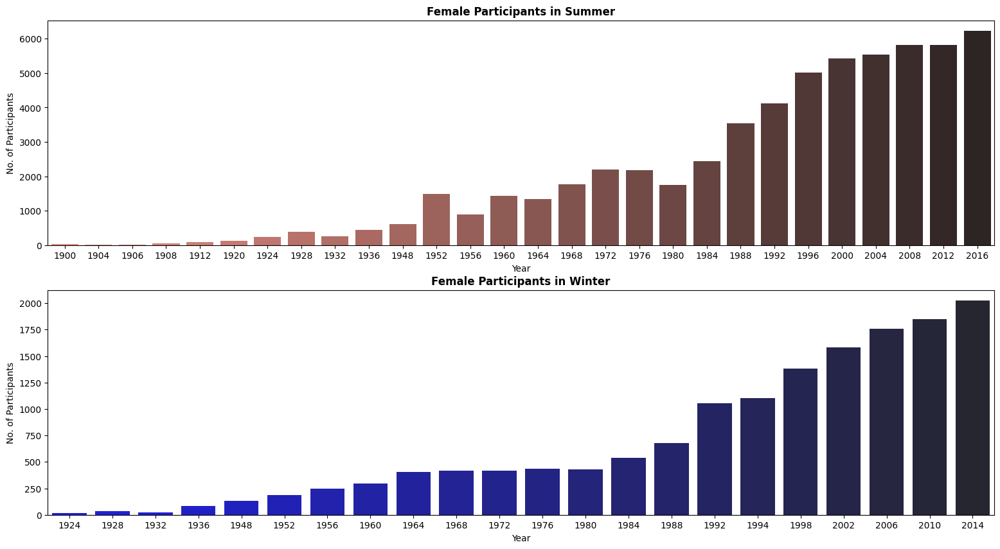

In [46]:
plt.figure(figsize=(19,10))

plt.subplot(211)
sns.countplot(data=data_female_summer,x="Year", palette="dark:salmon_r")
plt.title('Female Participants in Summer', weight="bold")
plt.ylabel("No. of Participants")

plt.subplot(212)
sns.countplot(data=data_female_winter,x="Year", palette="dark:blue_r")
plt.title('Female Participants in Winter', weight="bold")
plt.ylabel("No. of Participants")

plt.show()

- Up until 1920, there was an insignificant quantity of female athletes, but **after 1952**, there was a **sharp growth** in their numbers.

#### **6.2.6 Top 10 Medal winning Nations.**

In [47]:
winners = data[(data.Medal !='Not Winner')]
winners.head(3)

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
3,Edgar Lindenau Aabye,M,34.0,175.33897,70.702393,Denmark/Sweden,DEN,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,France
37,Arvo Ossian Aaltonen,M,30.0,175.33897,70.702393,Finland,FIN,1920,Summer,Antwerpen,Swimming,Swimming Men's 200 metres Breaststroke,Bronze,Finland,Belgium
38,Arvo Ossian Aaltonen,M,30.0,175.33897,70.702393,Finland,FIN,1920,Summer,Antwerpen,Swimming,Swimming Men's 400 metres Breaststroke,Bronze,Finland,Belgium


In [48]:
top_10_nation = winners.groupby("Team").count().reset_index().sort_values(by="Medal", ascending=False)[:10][["Team","Medal"]]
top_10_nation.style.background_gradient(cmap='Wistia')

,Team,Medal
462,United States,5219
403,Soviet Union,2451
165,Germany,1984
171,Great Britain,1673
149,France,1550
215,Italy,1527
420,Sweden,1434
18,Australia,1306
67,Canada,1243
198,Hungary,1127


- We note that the United States has sent the most athletes, and this table makes it very evident that the **United States** has taken home **5219 medals** overall over the years.

- Out of **top 10** countries there are **9 Western countries**.

#### **6.2.7 Top 5 Medal winning Nations performance year and season wise.**

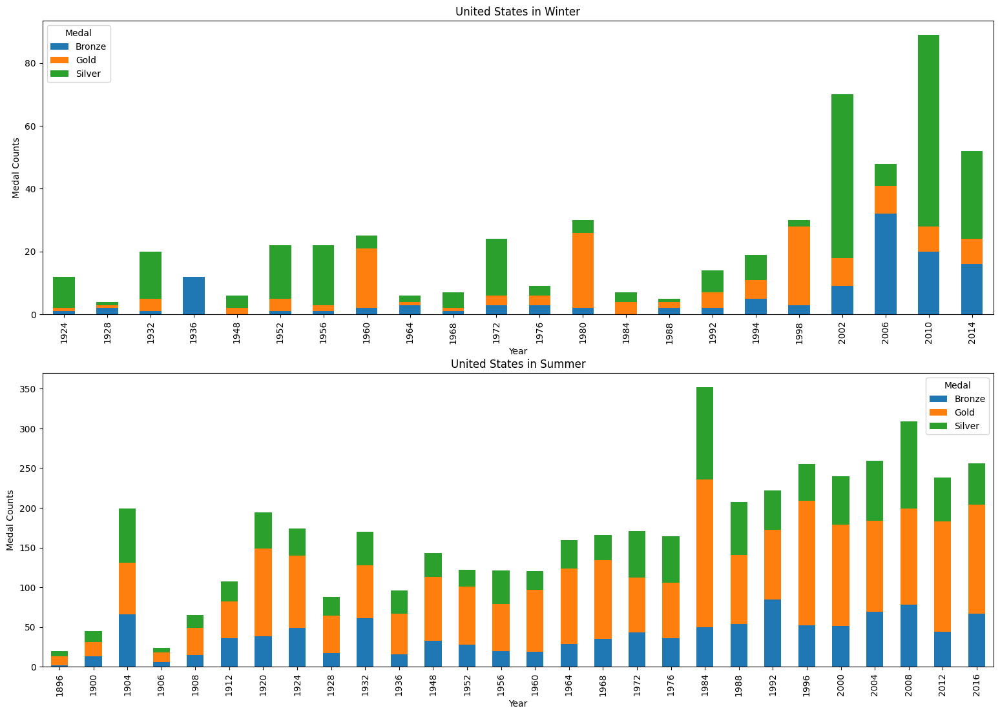

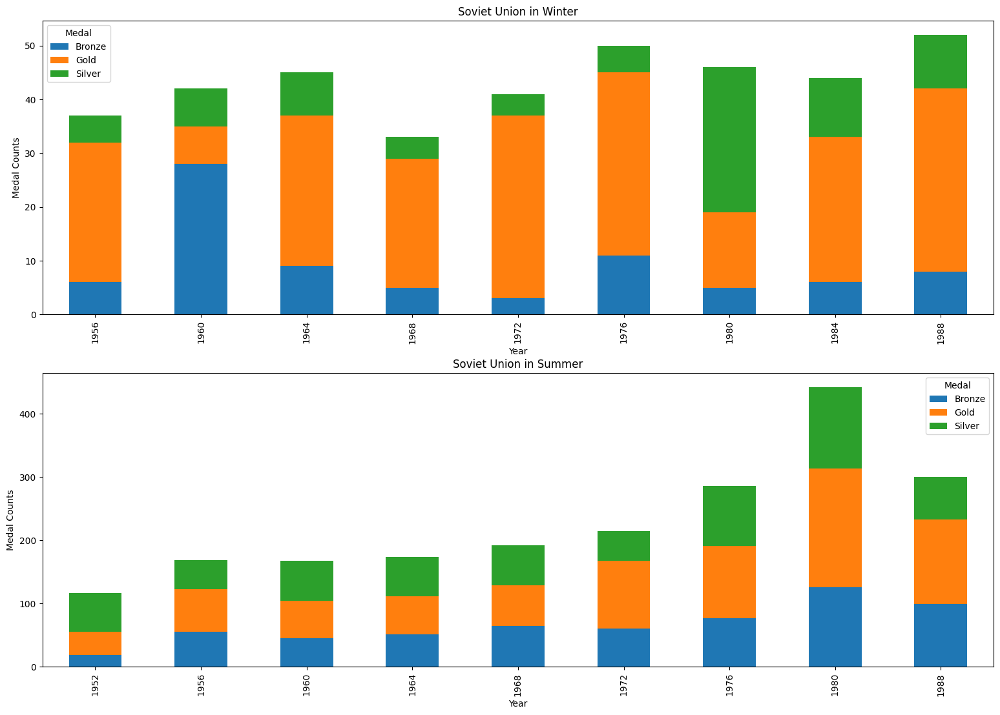

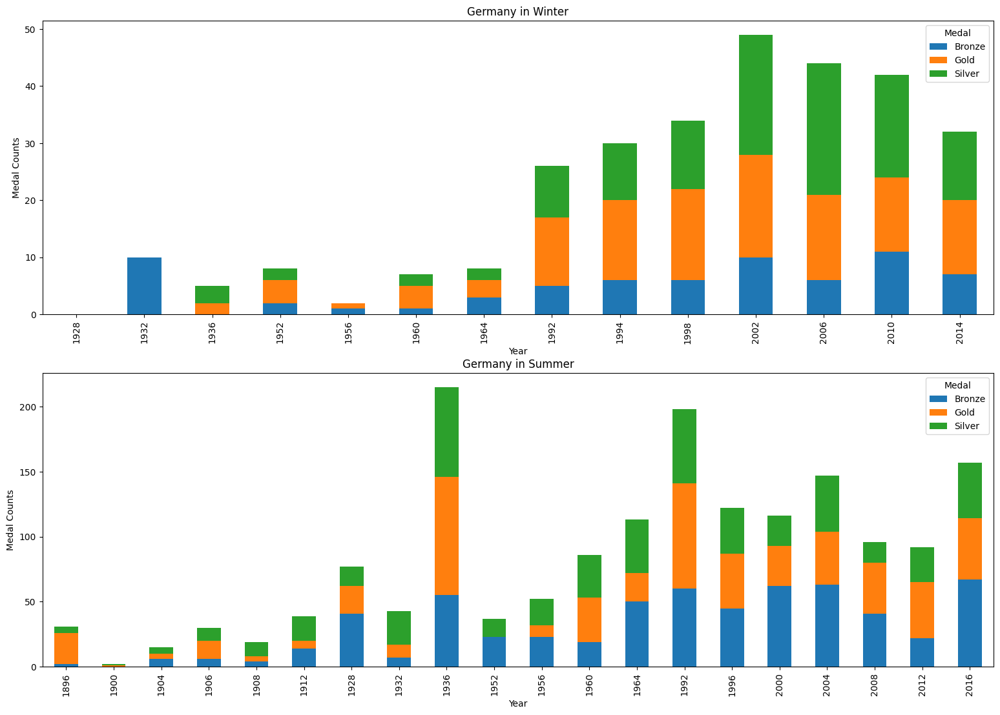

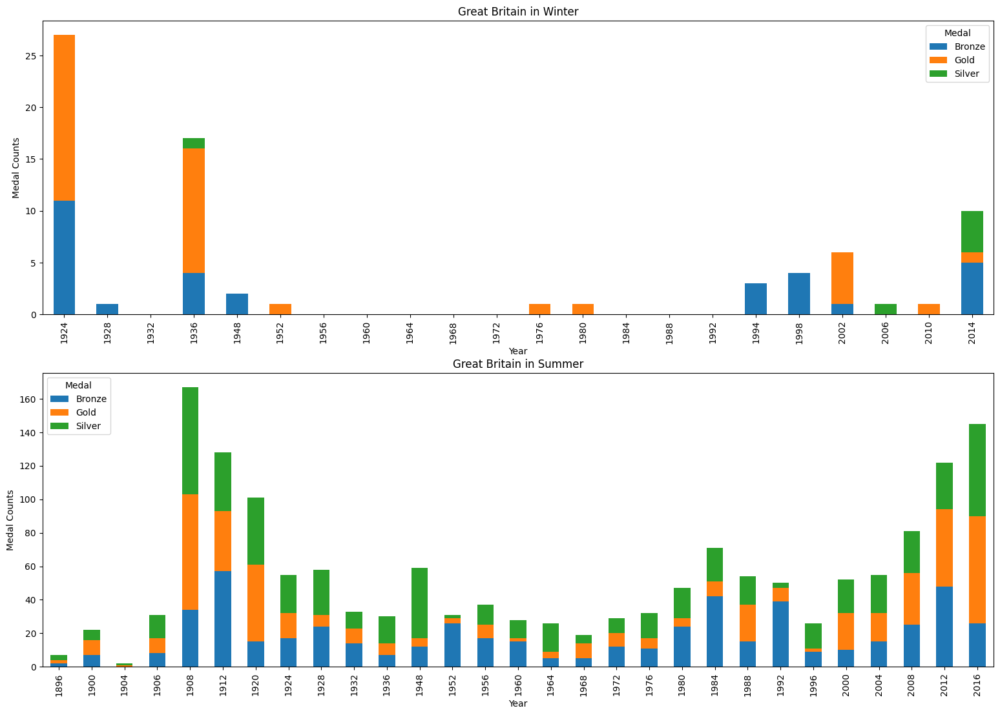

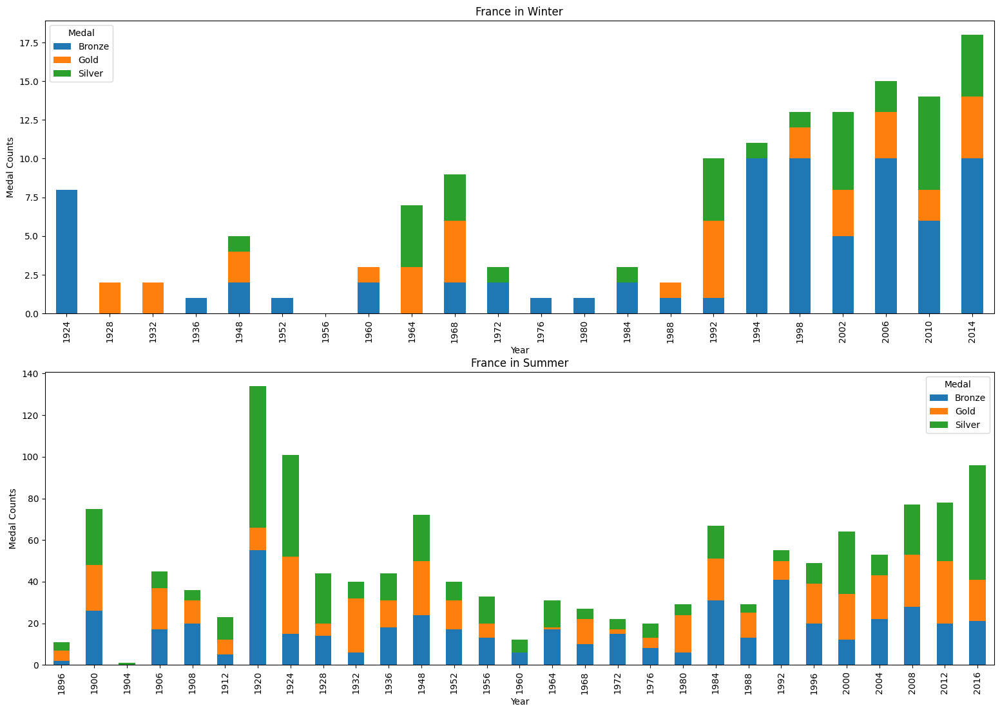

In [49]:
for i in top_10_nation.Team.head():
    medal_summer=data[(data['Team']==i) & (data['Season']=="Summer")].reset_index()

    medal_winter=data[(data['Team']==i) & (data['Season']=="Winter")].reset_index()

    yearly_medal_count_summer = medal_summer.groupby(["Medal","Year"]).size().reset_index().pivot(columns='Medal', index='Year', values=0).reset_index()

    yearly_medal_count_winter = medal_winter.groupby(["Medal","Year"]).size().reset_index().pivot(columns='Medal', index='Year', values=0).reset_index()

    yearly_medal_count_summer.plot(kind="bar", x="Year", y=["Bronze", "Gold","Silver"], stacked=True, figsize=(19,13), ax=plt.subplot(212), title=f"{i} in Summer")
    plt.ylabel("Medal Counts")

    yearly_medal_count_winter.plot(kind="bar", x="Year", y=["Bronze", "Gold","Silver"], stacked=True, figsize=(19,13), ax=plt.subplot(211), title=f"{i} in Winter")
    plt.ylabel("Medal Counts")
    plt.show()

- The number of **Gold medals** has always outnumbered Silver and Bronze medals for **United States**.

- Germany's medal count increased significantly following the Winter Olympics in 1964.

- Compared to the other top 5 nations, Great Britain has the least medals at the Winter Games, which also means that the majority of their medals come from the Summer Olympics.

#### **6.2.8 Top 10 nations to win Gold, Silver and Bronze medals respectively.**

In [50]:
data_gold = data[data["Medal"] == "Gold"].groupby(["Team"]).count().sort_values(ascending=False, by="Medal").reset_index()
data_gold.head(3)

,Team,Name,Sex,Age,Height,Weight,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
0,United States,2474,2474,2474,2474,2474,2474,2474,2474,2474,2474,2474,2474,2474,2474
1,Soviet Union,1058,1058,1058,1058,1058,1058,1058,1058,1058,1058,1058,1058,1058,1058
2,Germany,679,679,679,679,679,679,679,679,679,679,679,679,679,679


In [51]:
fig = go.Figure(data=[go.Pie(labels=data_gold.Team.head(10), values=data_gold.Medal, hole=0.8,
                             pull=[0.15,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05],
                             textinfo='label+value', title="<b>Top 10 Gold Winning Nations</b>")])

fig.update_layout(width=1150,height=600, margin=dict(t=50, l=25, r=25, b=25))
fig.show()

In [52]:
data_silver = data[data["Medal"] == "Silver"].groupby(["Team"]).count().sort_values(ascending=False, by="Medal").reset_index()
data_silver.head(3)

,Team,Name,Sex,Age,Height,Weight,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
0,United States,1512,1512,1512,1512,1512,1512,1512,1512,1512,1512,1512,1512,1512,1512
1,Soviet Union,716,716,716,716,716,716,716,716,716,716,716,716,716,716
2,Germany,627,627,627,627,627,627,627,627,627,627,627,627,627,627


In [53]:
fig = go.Figure(data=[go.Pie(labels=data_silver.Team.head(10), values=data_silver.Medal, hole=0.8,
                             pull=[0.15,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05],
                             textinfo='label+value', title="<b>Top 10 Silver Winning Nations</b>")])

fig.update_layout(width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25))
fig.show()

In [54]:
data_bronze = data[data["Medal"] == "Bronze"].groupby(["Team"]).count().sort_values(ascending=False, by="Medal").reset_index()
data_bronze.head(3)

,Team,Name,Sex,Age,Height,Weight,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
0,United States,1233,1233,1233,1233,1233,1233,1233,1233,1233,1233,1233,1233,1233,1233
1,Germany,678,678,678,678,678,678,678,678,678,678,678,678,678,678
2,Soviet Union,677,677,677,677,677,677,677,677,677,677,677,677,677,677


In [55]:
fig = go.Figure(data=[go.Pie(labels=data_bronze.Team.head(10), values=data_bronze.Medal, hole=0.8,
                             pull=[0.15,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05],
                             textinfo='label+value', title="<b>Top 10 Bronze Winning Nations</b>")])
fig.update_layout(width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25))

fig.show()

- The **US** also **dominates** every medal count in this area.

- There has not been a competitor for the **USSR** in second position since its disintegration in 1992.

- We can also find **East Germany** in the **top 10 places** for silver medal winners, which indicates there are still two countries on the list that no longer exist.

#### **6.2.9 Top 5 male & female athletes who won most medals across all sports.**

In [56]:
data_male = data[data['Sex']=='M']
data_male_medal_count = data_male[(data_male['Medal']!="Not Winner")].groupby(['Name',"Team","Sport"]).count().sort_values(by="Medal",ascending=False).reset_index()[:5]
data_male_medal_count.head()

,Name,Team,Sport,Sex,Age,Height,Weight,NOC,Year,Season,City,Event,Medal,region,Host_Country
0,"Michael Fred Phelps, II",United States,Swimming,28,28,28,28,28,28,28,28,28,28,28,28
1,Nikolay Yefimovich Andrianov,Soviet Union,Gymnastics,15,15,15,15,15,15,15,15,15,15,15,15
2,Ole Einar Bjrndalen,Norway,Biathlon,13,13,13,13,13,13,13,13,13,13,13,13
3,Edoardo Mangiarotti,Italy,Fencing,13,13,13,13,13,13,13,13,13,13,13,13
4,Takashi Ono,Japan,Gymnastics,13,13,13,13,13,13,13,13,13,13,13,13


In [57]:
fig = px.sunburst(data_male_medal_count, path=["Sport","Team","Name"], values="Medal",
            title="<b>Top 10 Male Athlete's by the Number of Medals Across all Sports</b>",
            color_continuous_scale='solar_r', color='Medal')

fig.update_layout(width=1100, height=500, margin=dict(t=50, l=25, r=25, b=25), title_x=0.5)

fig.show()

- Individually, American **Michael Phelps** has more medals than many other nations.

In [58]:
data_female=data[data['Sex']=='F']
data_female_medal_count= data_female[(data_female['Medal']!="Not Winner")].groupby(['Name',"Team","Sport"]).count().sort_values(by="Medal",ascending=False).reset_index()[:5]
data_female_medal_count.head()

,Name,Team,Sport,Sex,Age,Height,Weight,NOC,Year,Season,City,Event,Medal,region,Host_Country
0,Larysa Semenivna Latynina (Diriy-),Soviet Union,Gymnastics,18,18,18,18,18,18,18,18,18,18,18,18
1,"Jennifer Elisabeth ""Jenny"" Thompson (-Cumpelik)",United States,Swimming,12,12,12,12,12,12,12,12,12,12,12,12
2,Natalie Anne Coughlin (-Hall),United States,Swimming,12,12,12,12,12,12,12,12,12,12,12,12
3,"Dara Grace Torres (-Hoffman, -Minas)",United States,Swimming,12,12,12,12,12,12,12,12,12,12,12,12
4,Vra slavsk (-Odloilov),Czechoslovakia,Gymnastics,11,11,11,11,11,11,11,11,11,11,11,11


In [59]:
fig = px.sunburst(data_female_medal_count, path=["Sport","Team","Name"], values="Medal",
            title="<b>Top 10 Female Athlete's by the Number of Medals Across all Sports</b>",
            color_continuous_scale='sunsetdark', color='Medal')

fig.update_layout(width=1100, height=500, margin=dict(t=50, l=25, r=25, b=25), title_x=0.5)
fig.show()

- It appears that **swimmers** and **gymnasts** won the most medals, and the majority of these athletes are from the **US** and **USSR**.

#### **6.2.10 Athletes who win the medales with age over 50 years.**

In [60]:
winners["Age Above 50"] = np.nan
winners["Age Above 50"] = winners.Age>=50
winners_50 = winners[winners["Age Above 50"] == True]
winners_50.head()

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country,Age Above 50
3680,Abdullah Al-Rashidi,M,52.0,183.00000,83.000000,Individual Olympic Athletes,IOA,2016,Summer,Rio de Janeiro,Shooting,Shooting Men's Skeet,Bronze,Individual Olympic Athletes,Brazil,True
5077,Derek Swithin Allhusen,M,54.0,180.00000,71.000000,Great Britain,GBR,1968,Summer,Mexico City,Equestrianism,"Equestrianism Mixed Three-Day Event, Individual",Silver,UK,Mexico,True
5078,Derek Swithin Allhusen,M,54.0,180.00000,71.000000,Great Britain,GBR,1968,Summer,Mexico City,Equestrianism,"Equestrianism Mixed Three-Day Event, Team",Gold,UK,Mexico,True
7961,Johan August Anker,M,56.0,175.33897,70.702393,Norna,NOR,1928,Summer,Amsterdam,Sailing,Sailing Mixed 6 metres,Gold,Norway,Netherlands,True
13393,"Nikolaus ""Klaus"" Balkenhol",M,52.0,178.00000,83.000000,Germany,GER,1992,Summer,Barcelona,Equestrianism,"Equestrianism Mixed Dressage, Individual",Bronze,Germany,Spain,True


In [61]:
top_10_athelet_50 = winners_50.groupby(["Name","Sport","Sex","Age","Team"]).count().sort_values(by="Age Above 50", ascending =False)[:10].reset_index()
top_10_athelet_50.head()

,Name,Sport,Sex,Age,Team,Height,Weight,NOC,Year,Season,City,Event,Medal,region,Host_Country,Age Above 50
0,Gerard Theodor Hubert Van Innis,Archery,M,54.0,Belgium,6,6,6,6,6,6,6,6,6,6,6
1,Lon Ernest Moreaux,Shooting,M,54.0,France,5,5,5,5,5,5,5,5,5,5,5
2,Oscar Gomer Swahn,Shooting,M,60.0,Sweden,3,3,3,3,3,3,3,3,3,3,3
3,Thodore Lon Epin,Archery,M,61.0,France,3,3,3,3,3,3,3,3,3,3,3
4,Maurice Marie Lecoq,Shooting,M,52.0,France,3,3,3,3,3,3,3,3,3,3,3


In [62]:
fig = px.treemap(top_10_athelet_50, path=[px.Constant("All Athelet's"), "Name", "Sport", "Sex", "Age", "Team"],
                 values="Medal", color_continuous_scale='blugrn', color='Medal',
                 title="<b>Top 10 Athlete's with Age over 50 Years and win Medels</b>")

fig.update_traces(root_color="Black")
fig.update_layout(width=1150,height=550, margin = dict(t=50, l=25, r=25, b=25),title_x=0.5)
fig.show()

- At the age of **54**, **Gerard Theodor Hubert van Innis** won **6 medals** for Belgium.

- **9** of the **top 10** athletes are from **Europe**.

- Most people over 50 have been participating in **shooting** and **archery**.

#### **6.2.11 Top 5 countries hosted the most Olympic Events over the years.** 

In [63]:
total_events = data.drop_duplicates(subset=["Year"], keep="first")
total_events.head()

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
0,A Dijiang,M,24.0,180.00000,80.000000,China,CHN,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,Not Winner,China,Spain
1,A Lamusi,M,23.0,170.00000,60.000000,China,CHN,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,Not Winner,China,United Kingdom
2,Gunnar Nielsen Aaby,M,24.0,175.33897,70.702393,Denmark,DEN,1920,Summer,Antwerpen,Football,Football Men's Football,Not Winner,Denmark,Belgium
3,Edgar Lindenau Aabye,M,34.0,175.33897,70.702393,Denmark/Sweden,DEN,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,France
4,Christine Jacoba Aaftink,F,21.0,185.00000,82.000000,Netherlands,NED,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,Not Winner,Netherlands,Canada


In [64]:
country_fq_dictt = {}

for i in total_events.Host_Country:
    if i in country_fq_dictt:
        country_fq_dictt[i] += 1
    else:
        country_fq_dictt[i] = 1
country_fq = pd.DataFrame(country_fq_dictt.items(), columns=["Country","Hosted_Events"])
country_fq.head()

,Country,Hosted_Events
0,Spain,1
1,United Kingdom,3
2,Belgium,1
3,France,2
4,Canada,3


In [65]:
top_5_host_countries = country_fq.sort_values(by="Hosted_Events", ascending=False).head()
top_5_host_countries

,Country,Hosted_Events
6,United States,6
4,Canada,3
15,Greece,3
1,United Kingdom,3
19,Germany,2


In [66]:
fig = go.Figure(data=[go.Pie(labels=top_5_host_countries.Country, values=top_5_host_countries.Hosted_Events,
                             pull=[0.15,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05],
                             textinfo='label+value')])

fig.update_layout(width=1150,height=550, margin=dict(t=50, l=25, r=25, b=25),
                  title="<b>Top 5 Countries who held most Olympic Events</b>", title_x=0.5)

fig.show()

- **USA** has held the most Olympic events.

#### **6.2.12 Sports where athletes have won most number of medales.**

In [67]:
data_medal_no = data.Medal.replace(to_replace=["Gold","Silver","Bronze","Not Winner"], value=[1,1,1,np.nan]).reset_index()
data_medal_no.head()

,index,Medal
0,0,NaN
1,1,NaN
2,2,NaN
3,3,1.0
4,4,NaN


In [68]:
data_medal_no = pd.concat([data["Sport"],data["Sex"],data_medal_no["Medal"]],axis=1)
data_medal_no.dropna(inplace=True)
data_medal_no.head()

,Sport,Sex,Medal
3,Tug-Of-War,M,1.0
37,Swimming,M,1.0
38,Swimming,M,1.0
40,Ice Hockey,M,1.0
41,Gymnastics,M,1.0


In [69]:
fig = px.treemap(data_medal_no, path=[px.Constant("All Sports"), "Sport", "Sex"], values="Medal",
                 title="<b>Sports where Athelete's have Won most Medals</b>",
                 color_continuous_scale="redor", color="Sport")
fig.update_traces(root_color="Black")
fig.update_layout(width=1150,height=550, margin = dict(t=50, l=25, r=25, b=25), title_x=0.5)
fig.show()

- In our earlier observations, we noted that top 5 medallist and well-known sports are **Atheletics**, **Swimming** and **Gymnastics**. Now we know why.

- Compared to other sports, these sports offer **more number of events**.

#### **6.2.13 Number of Sport held throughout the years.**

In [70]:
fig = go.Figure()
no_of_sports = data.groupby(["Year","Season", "Sport"], as_index=False).count().groupby(["Year","Season"], as_index=False).count()

fig = px.line(no_of_sports, x="Year", y="Sport", color="Season", line_group="Season", markers=True)

fig.update_layout(width=1150,height=500, margin = dict(t=50, l=25, r=25, b=25),
                  title="<b>Number of Sport Organized through each Year</b>", title_x=0.5, xaxis_title="Year", yaxis_title="Sports")

fig.show()

- Sport events were inconsistent until **1960**, but after that there was an **ascending trajectory**.

- In contrast to the inaugural game in **Athens** (**9 Sports**), there are **34** Sports in the 2016 **Rio Olympics**.

#### **6.2.14 Number of athletes represent India in Olympics.**

In [71]:
IND_data = data[data["Team"] == "India"]
IND_data.groupby("Name").count().shape

(874, 14)

- **874** Athletes Participated under the banner of team **India**.

#### **6.2.15 Number of athletes win a medals for India in Olympics.**

In [72]:
IND_winners = IND_data[IND_data["Medal"] != "Not Winner"]
IND_winners.groupby("Name").count().shape

(148, 14)

- Out of 874 athletes **148 win medals!!**


- 148 medals! This is doubtful let's Google it. Till 2016 India won total **28 Medal** in olympics.[[1]](https://en.wikipedia.org/wiki/India_at_the_Olympics#:~:text=The%20nation%20first%20sent%20a,all%20at%20the%20Summer%20Games.)
Prehaps our **data is wrong?** Lets's check one more thing.

In [73]:
IND_winners[(IND_winners["Sport"] == "Hockey") & (IND_winners["Year"] == 1952)]

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
42474,Leslie Walter Claudius,M,25.0,162.00000,53.000000,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
48604,Meldric St. Clair daLuz Vieira,M,31.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
54180,Chinadorai Deshmutu,M,19.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
60357,Keshav Chandra Dutt,M,26.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
72086,Ranganathan Francis,M,32.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
131256,Raghbir Lal Sharma,M,22.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
186336,Govind Perumal,M,26.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
196093,Muniswamy Rajagopal,M,26.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
221020,"Grahanandan Nandy ""G. Nandy"" Singh",M,26.0,175.33897,79.000000,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland
221092,Kunwar Digvijay Singh,M,30.0,175.33897,70.702393,India,IND,1952,Summer,Helsinki,Hockey,Hockey Men's Hockey,Gold,India,Finland


- instead of tallying the medal of a **team event as one medal** to the nation, Our data is giving us **all the individials** who were a part of the team. That means our **data is good**.

#### **6.2.16 India's first participation at the Olympics.**

In [74]:
IND_data[(IND_data.Year== min(IND_data.Year)) & (IND_data.Medal!="Not Winner")]

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
193366,Norman Gilbert Pritchard (-Trevor),M,24.0,175.33897,70.702393,India,IND,1900,Summer,Paris,Athletics,Athletics Men's 200 metres,Silver,India,France
193368,Norman Gilbert Pritchard (-Trevor),M,24.0,175.33897,70.702393,India,IND,1900,Summer,Paris,Athletics,Athletics Men's 200 metres Hurdles,Silver,India,France


- **Norman Pritchard** was the first athelet to participate in Olympic from India.

- **Two silver** medals were won in his debut game.

#### **6.2.17 First female participant to win medal for IND at the Olympics.**

In [75]:
IND_winners[(IND_winners["Sex"] == "F")].sort_values(by="Year")[:1]

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
147709,Karnam Malleswari,F,25.0,163.0,60.0,India,IND,2000,Summer,Sydney,Weightlifting,Weightlifting Women's Light-Heavyweight,Bronze,India,Australia


- **Karnam Malleswari** became the first female athlete from India to win a medal in 2000's Summer Olympics.

#### **6.2.18 First Gold medal for IND at the Olympic Games.**

In [76]:
IND_winners[(IND_winners["Medal"] == "Gold")].sort_values(by="Year")[:10]

,Name,Sex,Age,Height,Weight,Team,NOC,Year,Season,City,Sport,Event,Medal,region,Host_Country
218235,Antarge Sherpa,M,25.556898,175.33897,70.702393,India,IND,1924,Winter,Chamonix,Alpinism,Alpinism Mixed Alpinism,Gold,India,France
218244,Temba Sherpa,M,25.556898,175.33897,70.702393,India,IND,1924,Winter,Chamonix,Alpinism,Alpinism Mixed Alpinism,Gold,India,France
218243,Sange Sherpa,M,25.556898,175.33897,70.702393,India,IND,1924,Winter,Chamonix,Alpinism,Alpinism Mixed Alpinism,Gold,India,France
218242,Pembra Sherpa,M,25.556898,175.33897,70.702393,India,IND,1924,Winter,Chamonix,Alpinism,Alpinism Mixed Alpinism,Gold,India,France
218241,Pasang Sherpa,M,25.556898,175.33897,70.702393,India,IND,1924,Winter,Chamonix,Alpinism,Alpinism Mixed Alpinism,Gold,India,France
218240,Narbu Sherpa,M,25.556898,175.33897,70.702393,India,IND,1924,Winter,Chamonix,Alpinism,Alpinism Mixed Alpinism,Gold,India,France
218239,Lhakpa Sherpa,M,25.556898,175.33897,70.702393,India,IND,1924,Winter,Chamonix,Alpinism,Alpinism Mixed Alpinism,Gold,India,France
89524,Leslie Charles Hammond,M,23.000000,184.00000,70.702393,India,IND,1928,Summer,Amsterdam,Hockey,Hockey Men's Hockey,Gold,India,Netherlands
116859,"Feroz-ud-Din ""Feroze"" Khan",M,23.000000,175.33897,70.702393,India,IND,1928,Summer,Amsterdam,Hockey,Hockey Men's Hockey,Gold,India,Netherlands
150463,George Eric McCarthy Marthins,M,22.000000,175.33897,70.702393,India,IND,1928,Summer,Amsterdam,Hockey,Hockey Men's Hockey,Gold,India,Netherlands


- India won **seven gold** medals in the **1924 Winter** Olympics.

#### **6.2.19 Various sports where India participated.**

In [77]:
print(IND_data.Sport.unique())
print(len(IND_data.Sport.unique()))

['Athletics' 'Table Tennis' 'Weightlifting' 'Judo' 'Water Polo'
 'Equestrianism' 'Football' 'Hockey' 'Alpine Skiing' 'Tennis' 'Cycling'
 'Wrestling' 'Golf' 'Badminton' 'Swimming' 'Archery' 'Shooting' 'Sailing'
 'Boxing' 'Rowing' 'Gymnastics' 'Art Competitions' 'Basketball'
 'Cross Country Skiing' 'Luge' 'Diving' 'Alpinism']
27


- There are **27** different **sports** in which Team India participated..

- Now let's check in which sport we win most medals.

#### **6.2.20 Sports where India won it's most medals.**

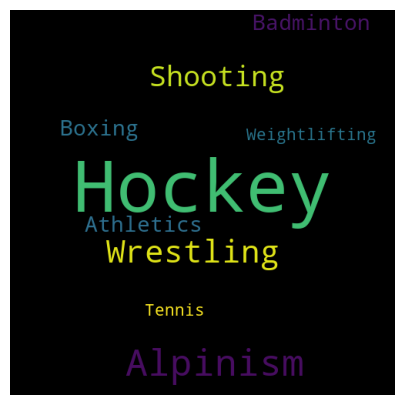

In [78]:
stopwords = set(STOPWORDS)
x = (IND_winners.Sport).to_string()

WC = WordCloud(width=500, height=500, background_color="Black",
               min_font_size=10, stopwords=stopwords, collocations=False).generate(x)

plt.figure(figsize=(5,5))
plt.imshow(WC)
plt.axis("off")
plt.show()

- India received it's most medals in **hockey**.

<a id=Section7></a>
## **7. Conclusion**

- It is clear that over the years, maximum number of athletes have represented countries like the United States, the United Kingdom, France, Germany, Spain, Italy, Japan, Canada, and the Netherlands etc. This can be explained by their lavish investments in athletes and sports infrastructure.

- The median age of athletes is around 25 years. It can be backend by the the fact that the majority of people reach their peak physical potential between the ages of 20 to 30.

- There are 236 individuals who won the Olympic medals when they were over the age of 50.

- People over 50 have been participating in shooting and archery.These are the sports where having a strong mind is more important than having a strong body.

- There is still no rival for the Soviet Union's 2451 medals in second place since its dissolution in 1992.

- For the United States, the proportion of gold medals has always been higher than that of silver and bronze.

- The overall trends of the number of participants taking part in the Olympics has gradually tended upwards. However, at 3 instances(1932,1956 & 1980), there is a sudden drop in the number of participants. This can be explained in two parts:

    - 1932 Games were held during the worldwide Great Depression, with some nations not traveling to Los Angeles.[[2]](https://en.wikipedia.org/wiki/1932_Summer_Olympics)
    - During 1956 Games eight teams boycotted the Games for various reasons. Four teams (Egypt, Iraq, Cambodia and Lebanon) boycotted in response to the Suez Crisis, in which Egypt was invaded by Israel, France and the United Kingdom.Three teams (the Netherlands, Spain and Switzerland) boycotted in response to the Soviet invasion of Hungary, and the People's Republic of China's boycott was in response to a dispute with the Republic of China over the right to represent China.[[3]](https://en.wikipedia.org/wiki/1956_Summer_Olympics)
    - Led by the United States in 1980, 66 countries boycotted the games entirely, because of the Soviet–Afghan War.[[4]](https://en.wikipedia.org/wiki/1980_Summer_Olympics)

- Initially, there are fewer female participants, but we are seeing an upward trend in participants over the years.

- The Height & Weight ratio of the athletes have higher in sports like Weightlifting and Basketball while other sports such as Gymnastics and Rhythmic Gymnastics have lower ratio.

- Two nations that are no longer in existence are still listed among the top 10 medal tally.

- Athletics and Gymnastics followed by Swimming have most number of corresponding events under them. The reason might be that they did not require any other sports accessories and they are the part of olympics since the first game.

- After analysing all the data and visual graphs, we can say that Western countries dominate in olpympics especially the United States.
    - Whether it's number of athletes, Highest medal tally or Host country.
    - Michael Fred Phelps (28), Jennifer Elisabeth Thompson (12), Natalie Anne Coughlin (12) and Dara Grace Torres (12) they win all those medals in swimming for USA.

- The summer Olympics have more sports than the winter Olympics.

- Females median age is less than that of males during each season.

- Overall, 148 individuals won medals for India.

- Norman Pritchard(M) and Karnam Malleswari(F) were the first Indian athletes to win medals..

- There are 27 sports in which Indian athletes have taken part.

- Out of 27 sports India only wins medals in 9 sports.



<a id=Section8></a>
## **8. Future Work**

- Does having a home advantage provide nations a benefit in terms of medals?

- We can additionally include the Paralympics data.

- Does the nation's Olympic accomplishment rely on its wealth (GDP)?

- How do a country's Olympics and climate relate to one another?

- Instead of tallying every individual for a team event we can count it as one medal.